In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scienceplots
#import time
#from scipy.optimize import minimize
#from sklearn.linear_model import LinearRegression
import glob
#import datetime
#import scipy
#from scipy.sparse import diags
#import statsmodels.stats.power as smp


#from scipy.linalg import solve_banded
#from mpl_toolkits.axes_grid1.inset_locator import inset_axes
#import matplotlib.ticker as ticker

from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error

In [2]:
mav_glob = glob.glob('../outputs/files/MAV_NtHat_hierarchical_2020/*.csv')

In [3]:
ground_truth_file_MAV = pd.read_csv('../outputs/files/census_pop/MAV_GT_manuscript.csv', sep=";")
ground_truth_file_MAV.dateStart = pd.to_datetime(ground_truth_file_MAV.dateStart)
ground_truth_file_MAV.rename(columns={'final_population':'Nt'}, inplace=True)


In [4]:
# lockdowns only
fl_sd, fl_ed = pd.to_datetime('2020-03-17'), pd.to_datetime('2020-05-10')
sl_sd, sl_ed = pd.to_datetime('2020-10-30'), pd.to_datetime('2020-12-14')

In [5]:
raw_data = ground_truth_file_MAV.copy()

In [6]:
raw_data.head()

,dateStart,traveling_factor,nominal_population,Nt
0,2020-01-01,0.0,332191,332191.0
1,2020-01-02,0.0,332191,332191.0
2,2020-01-03,0.0,332191,332191.0
3,2020-01-04,0.0,332191,332191.0
4,2020-01-05,0.0,332191,332191.0


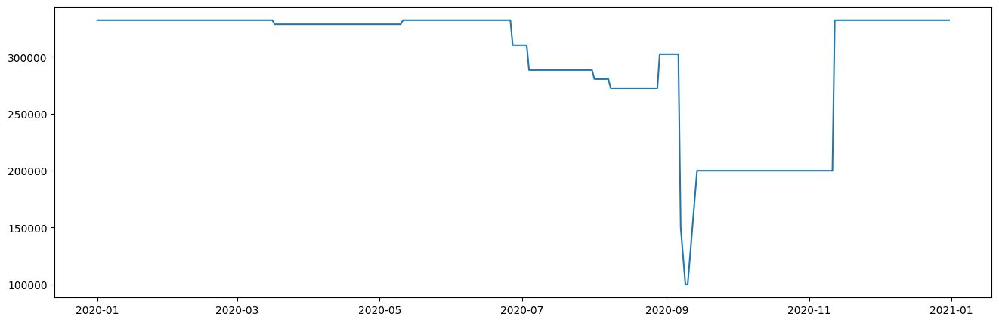

In [7]:
plt.figure(figsize=(16,5))
plt.plot(ground_truth_file_MAV.dateStart.values, ground_truth_file_MAV.Nt.values)

In [8]:
len(mav_glob)

3048

In [9]:
def compute_CR(target, CIL, CIU):
    considered = 0
    inside = 0
    
    for index in range(target.shape[0]):
        considered+=1
        if target[index] >= CIL[index] and target[index] <= CIU[index]:
            inside+=1

    return 100 * inside / considered

def compute_RMSE(target, estimate):
    return np.sqrt(mean_squared_error(target, estimate))

def compute_log_RMSE(target, estimate):
    return np.sqrt(mean_squared_error(np.log(target), np.log(estimate)))

def compute_MAPE(target, estimate):
    return mean_absolute_percentage_error(target, estimate)

In [10]:
np.random.seed(48)

nb_subsamplings = 1000

target = raw_data.loc[~raw_data['Nt'].isna()]

targets_list = []
for k in range(nb_subsamplings):
    sub_target = target.sample(frac=1.0, replace=True)
    targets_list.append(sub_target)

In [11]:
RMSES_dict_MAV = {}
log_RMSES_dict_MAV = {}
CR_dict_MAV = {}
MAPE_dict_MAV = {}
combi_targets = {}

for model_index, model_path in enumerate(mav_glob):
    model_name = model_path.split('/')[-1].split('.csv')[0]
    
    print('------')
    print(model_index, model_name)
    print('------')   

    estimate = pd.read_csv(model_path, sep=";")
    estimate.dateStart = pd.to_datetime(estimate.dateStart)

    check_targets_list = []
    RMSES_list = []
    RMSES_log_list = []
    MAPES_list = []
    for k in range(nb_subsamplings):
        sub_target = targets_list[k]
        sub_estimate = estimate.copy()
        sub_estimate.set_index('dateStart', inplace=True)
        sub_estimate = sub_estimate.loc[sub_target.dateStart.tolist()]

        this_RMSE = compute_RMSE(sub_target.Nt.values, sub_estimate.Nt_hat.values)
        RMSES_list.append(this_RMSE)

        this_RMSLE = compute_log_RMSE(sub_target.Nt.values, sub_estimate.Nt_hat.values)  
        RMSES_log_list.append(this_RMSLE)

        this_MAPE = compute_MAPE(sub_target.Nt.values, sub_estimate.Nt_hat.values)
        MAPES_list.append(this_MAPE)
        
    RMSES_dict_MAV[model_name] = RMSES_list
    log_RMSES_dict_MAV[model_name] = RMSES_log_list
    MAPE_dict_MAV[model_name] = MAPES_list

------
0 model_2_2_NTK-MES
------
------
1 model_4_6_DCO-NTK-NGL-MES
------
------
2 model_2_1_NH4-DBO-MES
------
------
3 model_3_1_DCO-PT
------
------
4 model_2_1_NH4-DCO-MES
------
------
5 model_4_3_NH4-DCO-NTK-NGL
------
------
6 model_4_6_NH4-DCO-DBO-NTK-NGL
------
------
7 model_8_0_DCO-DBO-PT
------
------
8 model_4_5_DCO-DBO-NTK-NGL-MES
------
------
9 model_2_5_NH4-NTK-NGL-PT-MES
------
------
10 model_4_4_NH4-DCO-NTK-NGL-MES
------
------
11 model_1_0_NH4-DCO-DBO-NGL-MES
------
------
12 model_4_3_NH4-DBO-NGL-PT
------
------
13 model_2_6_DCO-NTK-NGL
------
------
14 model_2_4_NTK-NGL
------
------
15 model_2_2_DCO-DBO-NGL-MES
------
------
16 model_3_5_NH4-DCO-NTK-PT
------
------
17 model_2_4_NH4-DCO-NTK-MES
------
------
18 model_4_4_NH4-DBO-NTK-NGL-PT
------
------
19 model_3_1_NH4-DCO-DBO
------
------
20 model_8_0_NH4-DCO-DBO-NTK
------
------
21 model_4_4_NH4-DCO-DBO-NTK-NGL-PT
------
------
22 model_2_4_NGL-PT-MES
------
------
23 model_4_1_DCO-PT
------
------
24 m

In [12]:
sev_glob = glob.glob('../outputs/files/SEV_NtHat_hierarchical_2020/*.csv')

In [13]:
ground_truth_file_SEV = pd.read_csv('../outputs/files/census_pop/SEV_GT_manuscript.csv', sep=";")
ground_truth_file_SEV.dateStart = pd.to_datetime(ground_truth_file_SEV.dateStart)
ground_truth_file_SEV.rename(columns={'final_population':'Nt'}, inplace=True)


In [14]:
# lockdowns only
fl_sd, fl_ed = pd.to_datetime('2020-03-17'), pd.to_datetime('2020-05-10')
sl_sd, sl_ed = pd.to_datetime('2020-10-30'), pd.to_datetime('2020-12-14')

In [15]:
raw_data = ground_truth_file_SEV.copy()

In [16]:
raw_data.head()

,dateStart,traveling_factor,nominal_population,Nt
0,2020-01-01,0.0,2452889,2452889.0
1,2020-01-02,0.0,2452889,2452889.0
2,2020-01-03,0.0,2452889,2452889.0
3,2020-01-04,0.0,2452889,2452889.0
4,2020-01-05,0.0,2452889,2452889.0


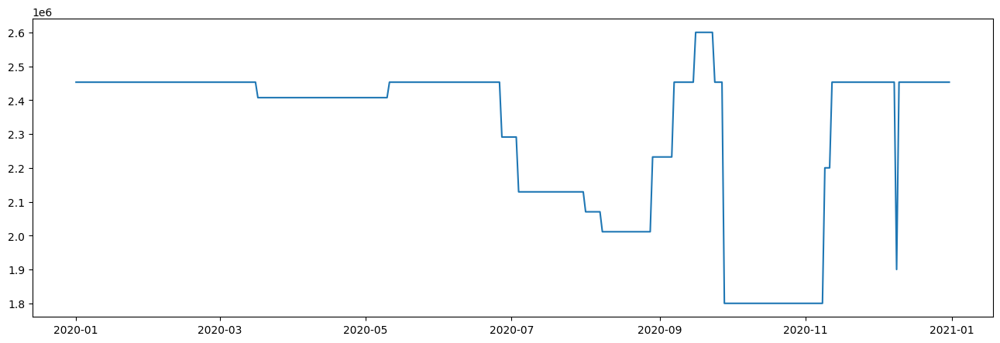

In [17]:
plt.figure(figsize=(16,5))
plt.plot(ground_truth_file_SEV.dateStart.values, ground_truth_file_SEV.Nt.values)

In [18]:
len(sev_glob)

3048

In [19]:
np.random.seed(48)

nb_subsamplings = 1000

target = raw_data.loc[~raw_data['Nt'].isna()]

targets_list = []
for k in range(nb_subsamplings):
    sub_target = target.sample(frac=1.0, replace=True)
    targets_list.append(sub_target)

In [20]:
RMSES_dict_SEV = {}
log_RMSES_dict_SEV = {}
CR_dict_SEV = {}
MAPE_dict_SEV = {}
combi_targets = {}

for model_index, model_path in enumerate(sev_glob):
    model_name = model_path.split('/')[-1].split('.csv')[0]
    
    print('------')
    print(model_index, model_name)
    print('------')   

    estimate = pd.read_csv(model_path, sep=";")
    estimate.dateStart = pd.to_datetime(estimate.dateStart)

    check_targets_list = []
    RMSES_list = []
    RMSES_log_list = []
    MAPES_list = []
    for k in range(nb_subsamplings):
        sub_target = targets_list[k]
        sub_estimate = estimate.copy()
        sub_estimate.set_index('dateStart', inplace=True)
        sub_estimate = sub_estimate.loc[sub_target.dateStart.tolist()]

        this_RMSE = compute_RMSE(sub_target.Nt.values, sub_estimate.Nt_hat.values)
        RMSES_list.append(this_RMSE)

        this_RMSLE = compute_log_RMSE(sub_target.Nt.values, sub_estimate.Nt_hat.values)  
        RMSES_log_list.append(this_RMSLE)

        this_MAPE = compute_MAPE(sub_target.Nt.values, sub_estimate.Nt_hat.values)
        MAPES_list.append(this_MAPE)
        
    RMSES_dict_SEV[model_name] = RMSES_list
    log_RMSES_dict_SEV[model_name] = RMSES_log_list
    MAPE_dict_SEV[model_name] = MAPES_list

------
0 model_2_2_NTK-MES
------
------
1 model_4_6_DCO-NTK-NGL-MES
------
------
2 model_2_1_NH4-DBO-MES
------
------
3 model_3_1_DCO-PT
------
------
4 model_2_1_NH4-DCO-MES
------
------
5 model_4_3_NH4-DCO-NTK-NGL
------
------
6 model_4_6_NH4-DCO-DBO-NTK-NGL
------
------
7 model_8_0_DCO-DBO-PT
------
------
8 model_4_5_DCO-DBO-NTK-NGL-MES
------
------
9 model_2_5_NH4-NTK-NGL-PT-MES
------
------
10 model_4_4_NH4-DCO-NTK-NGL-MES
------
------
11 model_1_0_NH4-DCO-DBO-NGL-MES
------
------
12 model_4_3_NH4-DBO-NGL-PT
------
------
13 model_2_6_DCO-NTK-NGL
------
------
14 model_2_4_NTK-NGL
------
------
15 model_2_2_DCO-DBO-NGL-MES
------
------
16 model_3_5_NH4-DCO-NTK-PT
------
------
17 model_2_4_NH4-DCO-NTK-MES
------
------
18 model_4_4_NH4-DBO-NTK-NGL-PT
------
------
19 model_3_1_NH4-DCO-DBO
------
------
20 model_8_0_NH4-DCO-DBO-NTK
------
------
21 model_4_4_NH4-DCO-DBO-NTK-NGL-PT
------
------
22 model_2_4_NGL-PT-MES
------
------
23 model_4_1_DCO-PT
------
------
24 m

In [21]:
sorted_RMSES_dict_SEV = dict(sorted(RMSES_dict_SEV.items(), key=lambda x: x[1]))
sorted_log_RMSES_dict_SEV = dict(sorted(log_RMSES_dict_SEV.items(), key=lambda x: x[1]))
sorted_MAPE_dict_SEV = dict(sorted(MAPE_dict_SEV.items(), key=lambda x: x[1]))

In [22]:
sorted_RMSES_dict_MAV = dict(sorted(RMSES_dict_MAV.items(), key=lambda x: x[1]))
sorted_log_RMSES_dict_MAV = dict(sorted(log_RMSES_dict_MAV.items(), key=lambda x: x[1]))
sorted_MAPE_dict_MAV = dict(sorted(MAPE_dict_MAV.items(), key=lambda x: x[1]))

In [23]:
sorted_RMSES_dict_SEV

{'model_4_2_DCO-DBO-NGL-PT-MES': [138987.21118366942,
  146077.7467787784,
  147012.47574888656,
  141979.3677184891,
  156465.20236092882,
  136537.09491369146,
  149565.82934732476,
  144963.0466358168,
  144288.07686351537,
  140055.98577050283,
  138505.2407896675,
  141916.74405999217,
  144122.99728776034,
  146807.324742431,
  144839.0682162567,
  146633.49649373733,
  140113.8886315651,
  148716.66734079388,
  153355.27032261103,
  150534.93477750075,
  139417.2956178536,
  139544.67289242338,
  138923.7501594029,
  148913.3327774766,
  143564.07657443846,
  144840.88029810417,
  149350.95078376634,
  152355.26621620325,
  150800.70500931342,
  132455.73520325593,
  145825.19724835077,
  147920.20535368123,
  142375.6861579179,
  139262.91816179303,
  145841.90919013927,
  147036.61759440094,
  155126.7015044255,
  147327.20503217948,
  143769.83147011252,
  134433.4288233431,
  151503.22088126797,
  140897.35961145407,
  133463.28710504968,
  141900.63384949058,
  144052.16948

In [24]:
wwtp = 'SEV'
metric = 'RMSE'

for model in list(sorted_RMSES_dict_SEV.keys()):
    output = pd.DataFrame(sorted_RMSES_dict_SEV[model], columns=['error'])
    output.to_csv('../outputs/files/model_assessment_bootstrap_hierarchical_QIJ_2020/' + wwtp + '_' + metric + '_' + model + '.csv', sep=';')

OSError: Cannot save file into a non-existent directory: '../outputs/files/model_assessment_bootstrap_hierarchical_QIJ_2020'

In [ ]:
wwtp = 'SEV'
metric = 'RMSLE'

for model in list(sorted_log_RMSES_dict_SEV.keys()):
    output = pd.DataFrame(sorted_log_RMSES_dict_SEV[model], columns=['error'])
    output.to_csv('../outputs/files/model_assessment_bootstrap_hierarchical_QIJ_2020/' + wwtp + '_' + metric + '_' + model + '.csv', sep=';')

In [25]:
wwtp = 'SEV'
metric = 'MAPE'

for model in list(sorted_MAPE_dict_SEV.keys()):
    output = pd.DataFrame(sorted_MAPE_dict_SEV[model], columns=['error'])
    output.to_csv('../outputs/files/model_assessment_bootstrap_hierarchical_QIJ_2020/' + wwtp + '_' + metric + '_' + model + '.csv', sep=';')

OSError: Cannot save file into a non-existent directory: '../outputs/files/model_assessment_bootstrap_hierarchical_QIJ_2020'

In [26]:
wwtp = 'MAV'
metric = 'RMSE'

for model in list(sorted_RMSES_dict_MAV.keys()):
    output = pd.DataFrame(sorted_RMSES_dict_MAV[model], columns=['error'])
    output.to_csv('../outputs/files/model_assessment_bootstrap_hierarchical_QIJ_2020/' + wwtp + '_' + metric + '_' + model + '.csv', sep=';')

OSError: Cannot save file into a non-existent directory: '../outputs/files/model_assessment_bootstrap_hierarchical_QIJ_2020'

In [102]:
wwtp = 'MAV'
metric = 'RMSLE'

for model in list(sorted_log_RMSES_dict_MAV.keys()):
    output = pd.DataFrame(sorted_log_RMSES_dict_MAV[model], columns=['error'])
    output.to_csv('../outputs/files/model_assessment_bootstrap_hierarchical_QIJ_2020/' + wwtp + '_' + metric + '_' + model + '.csv', sep=';')

In [103]:
wwtp = 'MAV'
metric = 'MAPE'

for model in list(sorted_MAPE_dict_MAV.keys()):
    output = pd.DataFrame(sorted_MAPE_dict_MAV[model], columns=['error'])
    output.to_csv('../outputs/files/model_assessment_bootstrap_hierarchical_QIJ_2020/' + wwtp + '_' + metric + '_' + model + '.csv', sep=';')

In [31]:
# first step, take the mean of the RMSLE for each wwtp

In [27]:
def get_mean_of_errors(input_dict):

    output_dict = {}
    for model in list(input_dict.keys()):
        these_errors_mean = np.mean(input_dict[model])
        output_dict[model] = these_errors_mean

    sorted_output_dict = dict(sorted(output_dict.items(), key=lambda x: x[1]))

    return sorted_output_dict

In [28]:
# stopped here

In [29]:
RMSLE_SEV_mean = get_mean_of_errors(sorted_log_RMSES_dict_SEV)
RMSLE_MAV_mean = get_mean_of_errors(sorted_log_RMSES_dict_MAV)

In [53]:
RMSLE_MAV_mean['model_3_3_NH4-DCO-DBO-NGL'], RMSLE_SEV_mean['model_3_3_NH4-DCO-DBO-NGL']

(0.09277642353222001, 0.06862331255091937)

In [54]:
RMSLE_MAV_mean['model_3_3_NH4-DCO-NTK-NGL-PT-MES'], RMSLE_SEV_mean['model_3_3_NH4-DCO-NTK-NGL-PT-MES']

(0.09492995274778761, 0.06949155591953954)

In [55]:
RMSLE_MAV_mean['model_2_4_PT'], RMSLE_SEV_mean['model_2_4_PT']

(0.09307780140145287, 0.07865084808355062)

In [33]:
temp = {}
for key in list(RMSLE_SEV_mean.keys()):
    SEV_error = RMSLE_SEV_mean[key]
    MAV_error = RMSLE_MAV_mean[key]
    avg_error = (SEV_error + MAV_error) / 2

    temp[key] = avg_error

RMSLE_overall_mean = dict(sorted(temp.items(), key=lambda x: x[1]))

In [57]:
RMSLE_MAV_mean['model_3_4_NH4-DCO-DBO-NTK-NGL']

0.0868823080972975

In [34]:
RMSLE_overall_mean

{'model_3_4_NH4-DCO-DBO-NTK-NGL': 0.0802375763119483,
 'model_3_3_NH4-DCO-DBO-NGL': 0.0806998680415697,
 'model_3_3_NH4-DCO-NTK-NGL-MES': 0.08073798268358531,
 'model_3_3_NH4-DCO-DBO-NGL-PT': 0.08082493549730624,
 'model_3_3_NH4-DCO-DBO-NTK': 0.0809306675858886,
 'model_4_3_NH4-DCO-NTK-NGL': 0.08124622918552067,
 'model_2_3_NH4-DCO-NTK-NGL-PT': 0.0812508976930516,
 'model_2_3_NH4-DCO-NTK-NGL': 0.08125198318979986,
 'model_4_3_NH4-DCO-NTK-NGL-PT': 0.08125635107316162,
 'model_4_3_NH4-DCO-DBO-NGL': 0.08127219195721917,
 'model_2_3_NH4-DCO-DBO-NTK-NGL-PT': 0.08128346526371798,
 'model_2_3_NH4-DCO-DBO-NTK-NGL': 0.08128347162056387,
 'model_4_3_NH4-DCO-DBO-NTK-NGL-PT': 0.08129369264425743,
 'model_4_4_NH4-DCO-DBO-NTK-NGL': 0.08130862979898722,
 'model_4_4_NH4-DCO-NTK-NGL-PT': 0.08133063570784507,
 'model_4_3_NH4-DCO-DBO-NTK-NGL': 0.0813336277213334,
 'model_2_3_DCO-NTK-NGL-PT': 0.08133397107578638,
 'model_2_3_DCO-NTK-NGL': 0.08133548107779981,
 'model_3_3_NH4-DCO-NGL': 0.08133549166680018,

In [35]:
# but this doesnt take the variance into account
# so we want to get an error metric that fit our needs
# i) we want to minimize the error
# ii) jointly with having the least variance possible

In [36]:
np.std(np.array([SEV_error, MAV_error]))

1.598479496907586

In [37]:
(np.abs(SEV_error - MAV_error)) / np.sqrt(2)

2.26059138370203

In [38]:
np.mean([SEV_error, MAV_error])

1.7296474962288122

In [39]:
temp = {}
for key in list(RMSLE_SEV_mean.keys()):
    SEV_error = RMSLE_SEV_mean[key]
    MAV_error = RMSLE_MAV_mean[key]
    errors_vector = np.array([SEV_error, MAV_error])
    mean_error = np.mean(errors_vector)
    #std_error = np.std(errors_vector)#np.abs(SEV_error - MAV_error)# cant use std in a two dimensional case because the error only accounts for the max error then
    std_error = np.abs(SEV_error - MAV_error) 
    
    temp[key] = 2 * mean_error + std_error

RMSLE_overall_error = dict(sorted(temp.items(), key=lambda x: x[1]))

In [40]:
RMSLE_overall_error

{'model_3_4_NH4-DCO-DBO-NTK-NGL': 0.173764616194595,
 'model_2_4_NH4-NGL-PT': 0.1753132869614042,
 'model_2_4_NH4-NGL': 0.17543859640650095,
 'model_2_4_NH4-NTK-NGL-PT': 0.17548800269856174,
 'model_2_4_NH4-NTK-NGL': 0.17557045344833191,
 'model_1_0_NGL-PT': 0.1758142519305624,
 'model_2_4_NGL-PT': 0.1761402242533299,
 'model_4_4_NH4-NTK-NGL-PT': 0.17625441500631087,
 'model_3_4_NH4-NTK-NGL-PT': 0.17625441500631087,
 'model_3_4_NH4-NTK-NGL': 0.17634217148064163,
 'model_4_4_NH4-NTK-NGL': 0.17634217148064163,
 'model_1_0_NGL': 0.17641693587959195,
 'model_4_4_NH4-NGL-PT': 0.17655123546785112,
 'model_3_4_NH4-NGL-PT': 0.17655123546785112,
 'model_3_4_NH4-NGL': 0.17670548969258343,
 'model_4_4_NH4-NGL': 0.17670548969258343,
 'model_4_4_NH4-DCO-DBO-NTK-NGL': 0.17828988718074432,
 'model_2_4_NH4-DCO-DBO-NTK-NGL-PT': 0.17829941571581315,
 'model_2_4_NH4-DCO-DBO-NTK-NGL': 0.17830315749413225,
 'model_4_4_NH4-DCO-DBO-NTK-NGL-PT': 0.17834703113844916,
 'model_3_4_NGL-PT': 0.17846668537153057,
 

In [41]:
best_model_sev = 'model_2_4_PT'

for model_index, model_path in enumerate(sev_glob):
    model_name = model_path.split('/')[-1].split('.csv')[0]

    if model_name==best_model_sev:  
        estimate = pd.read_csv(model_path, sep=";")
        estimate.dateStart = pd.to_datetime(estimate.dateStart)
        print('Found it')
        break

Found it


In [42]:
best_model_sev = 'model_3_3_NH4-DCO-DBO-NGL'

for model_index, model_path in enumerate(sev_glob):
    model_name = model_path.split('/')[-1].split('.csv')[0]

    if model_name==best_model_sev:  
        alt_estimate = pd.read_csv(model_path, sep=";")
        alt_estimate.dateStart = pd.to_datetime(alt_estimate.dateStart)
        print('Found it')
        break

Found it


In [43]:
best_model_sev = 'model_3_4_NH4-DCO-DBO-NTK-NGL'#'model_3_3_NH4-DCO-DBO-NGL'

for model_index, model_path in enumerate(sev_glob):
    model_name = model_path.split('/')[-1].split('.csv')[0]

    if model_name==best_model_sev:  
        alt_estimate_2 = pd.read_csv(model_path, sep=";")
        alt_estimate_2.dateStart = pd.to_datetime(alt_estimate_2.dateStart)
        print('Found it')
        break

Found it


In [44]:
best_model_sev = 'model_8_0_NH4'#'model_2_4_NH4-NGL-PT'#'model_3_3_NH4-DCO-DBO-NGL'

for model_index, model_path in enumerate(sev_glob):
    model_name = model_path.split('/')[-1].split('.csv')[0]

    if model_name==best_model_sev:  
        alt_estimate_3 = pd.read_csv(model_path, sep=";")
        alt_estimate_3.dateStart = pd.to_datetime(alt_estimate_3.dateStart)
        print('Found it')
        break

Found it


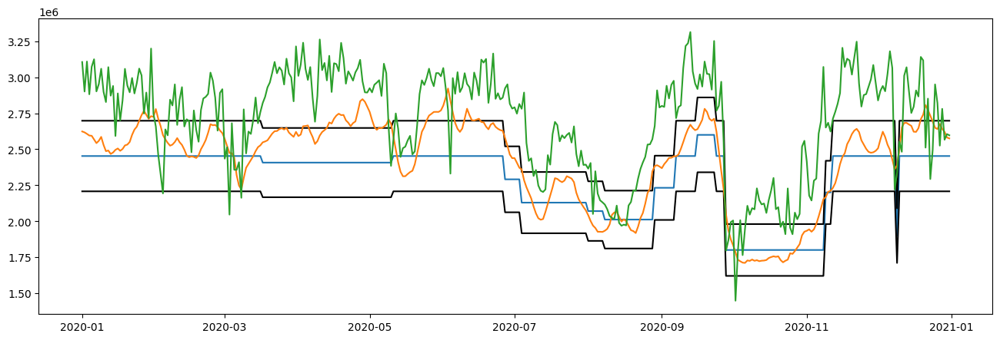

In [45]:
plt.figure(figsize=(16,5))
plt.plot(ground_truth_file_SEV.dateStart.values, ground_truth_file_SEV.Nt.values)
plt.plot(ground_truth_file_SEV.dateStart.values, 0.9*ground_truth_file_SEV.Nt.values, color='black')
plt.plot(ground_truth_file_SEV.dateStart.values, 1.1*ground_truth_file_SEV.Nt.values, color='black')
#plt.plot(estimate.dateStart.values, estimate.Nt_hat.values)
#plt.plot(alt_estimate.dateStart.values, alt_estimate.Nt_hat.values)
plt.plot(alt_estimate_2.dateStart.values, alt_estimate_2.Nt_hat.values)
plt.plot(alt_estimate_3.dateStart.values, alt_estimate_3.Nt_hat.values)

In [46]:
best_model_sev = 'model_2_4_PT'

for model_index, model_path in enumerate(mav_glob):
    model_name = model_path.split('/')[-1].split('.csv')[0]

    if model_name==best_model_sev:  
        estimate = pd.read_csv(model_path, sep=";")
        estimate.dateStart = pd.to_datetime(estimate.dateStart)
        print('Found it')
        break

Found it


In [47]:
best_model_sev = 'model_3_3_NH4-DCO-DBO-NGL'

for model_index, model_path in enumerate(mav_glob):
    model_name = model_path.split('/')[-1].split('.csv')[0]

    if model_name==best_model_sev:  
        alt_estimate = pd.read_csv(model_path, sep=";")
        alt_estimate.dateStart = pd.to_datetime(alt_estimate.dateStart)
        print('Found it')
        break

Found it


In [48]:
best_model_sev = 'model_3_4_NH4-DCO-DBO-NTK-NGL'#'model_3_3_NH4-DCO-DBO-NGL'

for model_index, model_path in enumerate(mav_glob):
    model_name = model_path.split('/')[-1].split('.csv')[0]

    if model_name==best_model_sev:  
        alt_estimate_2 = pd.read_csv(model_path, sep=";")
        alt_estimate_2.dateStart = pd.to_datetime(alt_estimate_2.dateStart)
        print('Found it')
        break

Found it


In [49]:
best_model_sev = 'model_2_4_NH4-NGL-PT'#'model_3_3_NH4-DCO-DBO-NGL'

for model_index, model_path in enumerate(mav_glob):
    model_name = model_path.split('/')[-1].split('.csv')[0]

    if model_name==best_model_sev:  
        alt_estimate_3 = pd.read_csv(model_path, sep=";")
        alt_estimate_3.dateStart = pd.to_datetime(alt_estimate_3.dateStart)
        print('Found it')
        break

Found it


In [50]:
best_model_sev = 'model_8_0_NH4'#'model_3_3_NH4-DCO-DBO-NGL'

for model_index, model_path in enumerate(mav_glob):
    model_name = model_path.split('/')[-1].split('.csv')[0]

    if model_name==best_model_sev:  
        alt_estimate_3 = pd.read_csv(model_path, sep=";")
        alt_estimate_3.dateStart = pd.to_datetime(alt_estimate_3.dateStart)
        print('Found it')
        break

Found it


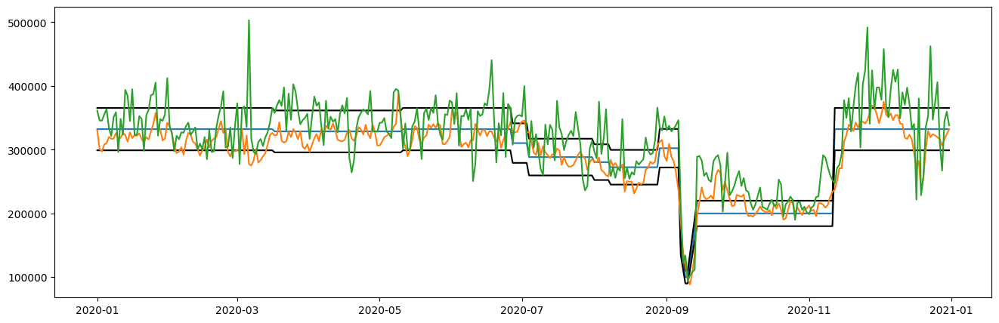

In [51]:
plt.figure(figsize=(16,5))
plt.plot(ground_truth_file_MAV.dateStart.values, ground_truth_file_MAV.Nt.values)
plt.plot(ground_truth_file_MAV.dateStart.values, 0.9*ground_truth_file_MAV.Nt.values, color='black')
plt.plot(ground_truth_file_MAV.dateStart.values, 1.1*ground_truth_file_MAV.Nt.values, color='black')
#plt.plot(estimate.dateStart.values, estimate.Nt_hat.values)
#plt.plot(alt_estimate.dateStart.values, alt_estimate.Nt_hat.values)
plt.plot(alt_estimate_2.dateStart.values, alt_estimate_2.Nt_hat.values)
plt.plot(alt_estimate_3.dateStart.values, alt_estimate_3.Nt_hat.values)

In [52]:
model = 'model_2_4_PT'
print(model, RMSLE_MAV_mean[model], RMSLE_SEV_mean[model], RMSLE_overall_error[model])

model = 'model_3_4_NH4-DCO-DBO-NTK-NGL'
print(model, RMSLE_MAV_mean[model], RMSLE_SEV_mean[model], RMSLE_overall_error[model])

model = 'model_2_4_NH4-NGL-PT'
print(model, RMSLE_MAV_mean[model], RMSLE_SEV_mean[model], RMSLE_overall_error[model])

model = 'model_1_0_NGL-PT'
print(model, RMSLE_MAV_mean[model], RMSLE_SEV_mean[model], RMSLE_overall_error[model])

model_2_4_PT 0.09307780140145287 0.07865084808355062 0.18615560280290575
model_3_4_NH4-DCO-DBO-NTK-NGL 0.0868823080972975 0.0735928445265991 0.173764616194595
model_2_4_NH4-NGL-PT 0.0876566434807021 0.0787855454372173 0.1753132869614042
model_1_0_NGL-PT 0.0879071259652812 0.0774498016761858 0.1758142519305624
